## Numerai Data Analysis and Prediction Using Principal Component Analysis and Logistic Regression
### [Numeria](https://numer.ai/about) is a global artificial intelligence tournament to predict the stock market.

In [7]:
%matplotlib inline

import matplotlib
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np 
from sklearn import decomposition
from sklearn.linear_model import LogisticRegression
from sklearn.naive_bayes import GaussianNB
from sklearn import metrics
import seaborn

/usr/local/lib/python2.7/dist-packages/IPython/html.py:14: ShimWarning: The `IPython.html` package has been deprecated. You should import from `notebook` instead. `IPython.html.widgets` has moved to `ipywidgets`.
  "`IPython.html.widgets` has moved to `ipywidgets`.", ShimWarning)


### Load both training and tournament dataset

In [4]:
train_df = pd.read_csv("numerai_data/numerai_training_data.csv")
test_df = pd.read_csv("numerai_data/numerai_tournament_data.csv")

In [5]:
train_features_df = train_df.ix[:,range(0,21)]

In [6]:
train_features_df.head()

,feature1,feature2,feature3,feature4,feature5,feature6,feature7,feature8,feature9,feature10,...,feature12,feature13,feature14,feature15,feature16,feature17,feature18,feature19,feature20,feature21
0,0.785612,0.390270,0.094361,0.519912,0.399099,0.344335,0.455511,0.761529,0.325698,0.526719,...,0.387789,0.096201,0.406935,0.770402,0.118117,0.645878,0.157368,0.555214,0.452174,0.490598
1,0.237196,0.439135,0.275033,0.397623,0.298562,0.319837,0.269499,0.364928,0.487469,0.472395,...,0.156764,0.113426,0.497513,0.221724,0.372211,0.379475,0.309344,0.466713,0.134196,0.344119
2,0.193834,0.188941,0.318120,0.011652,0.996810,0.194543,0.673584,0.065527,0.867718,0.952826,...,0.156764,0.028983,0.081980,0.262313,0.866146,0.984591,0.005319,0.362631,0.839367,0.864358
3,0.128284,0.247248,0.214744,0.479726,0.629181,0.240620,0.686727,0.247316,0.416373,0.480929,...,0.363211,0.531799,0.137859,0.448138,0.580745,0.615090,0.319804,0.158867,0.651985,0.642132
4,0.059109,0.105634,0.555476,0.313932,0.633265,0.040131,0.038417,0.491778,0.743255,0.815162,...,0.904285,0.803136,0.042358,0.962227,0.989375,0.775296,0.255458,0.054136,0.120341,0.471822


### Inspect Colinearity in data

/usr/lib/python2.7/dist-packages/matplotlib/collections.py:571: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if self._edgecolors == str('face'):


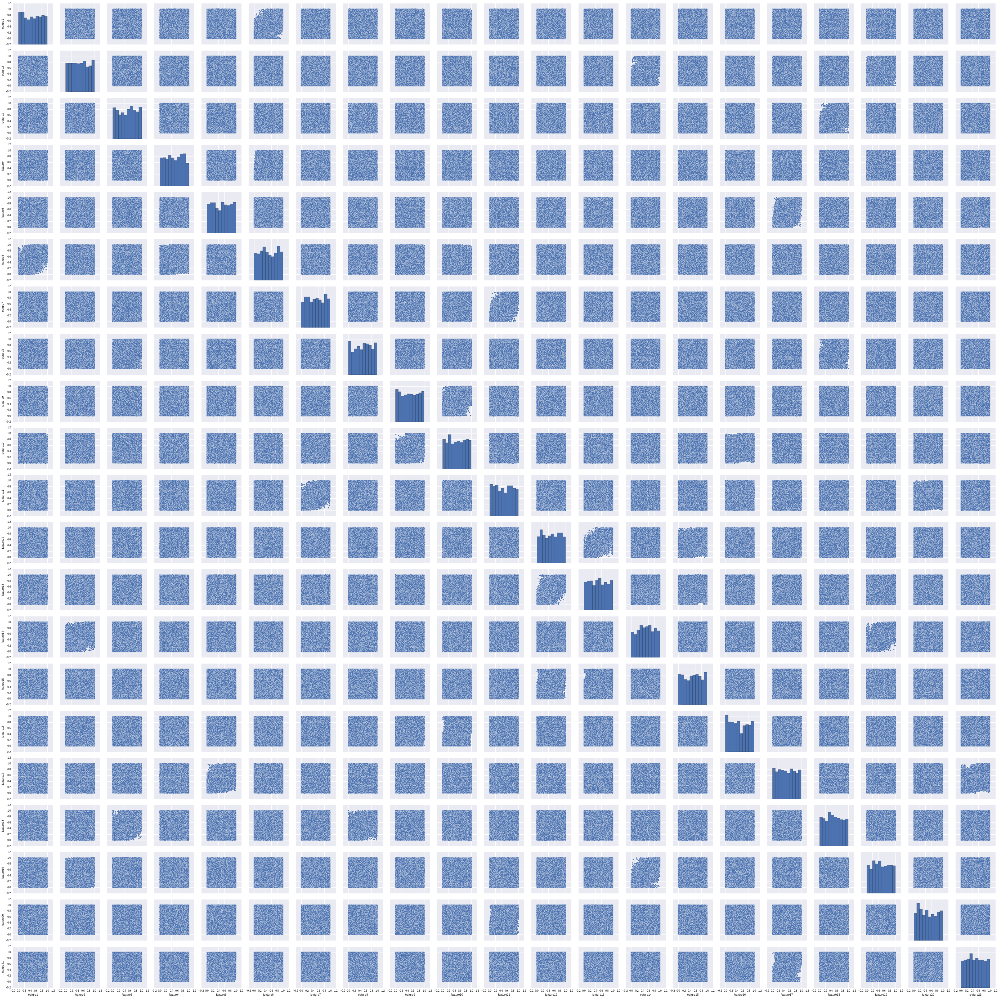

In [8]:
seaborn.pairplot(train_features_df)

### User defined functions

In [10]:
def computeTopFeaturesPCA(df, num_of_components=10):
    """ 
    This function performs PCA with top components 
    from pandas dataframe and returns a dataframe
    containing principal features
    """
    raw_matrix = df.as_matrix()
    pca = decomposition.PCA(n_components=num_of_components)
    reduced_matrix = pca.fit_transform(raw_matrix)
    return pd.DataFrame(reduced_matrix)


def mergeDFByColumn(df1, df2):
    """
    This function merges two dataframes by column
    and returns a new dataframe
    """
    merged_df = pd.concat([df1, df2], axis=1)
    return merged_df

In [11]:
train_reduced_df = computeTopFeaturesPCA(train_features_df)

In [12]:
train_reduced_df.head()

,0,1,2,3,4,5,6,7,8,9
0,-0.135041,0.336223,-0.120754,0.015917,-0.191340,-0.067127,0.033850,-0.158740,-0.076433,0.079802
1,-0.273709,0.211106,0.115552,-0.607145,-0.455373,-0.286743,0.134515,-0.002677,0.051068,-0.013161
2,1.144066,0.071588,-0.837514,-0.708459,-0.540568,-0.123382,-0.239667,-0.144035,0.138549,0.164463
3,0.564571,0.411345,-0.264677,-0.331694,-0.075474,-0.057602,0.192131,-0.247054,-0.023228,-0.104911
4,0.804005,0.467188,0.372105,-0.485091,0.652443,-0.539988,-0.346559,0.404857,0.130938,-0.035898


### Inspect Colinearity after reducing dimensions with PCA

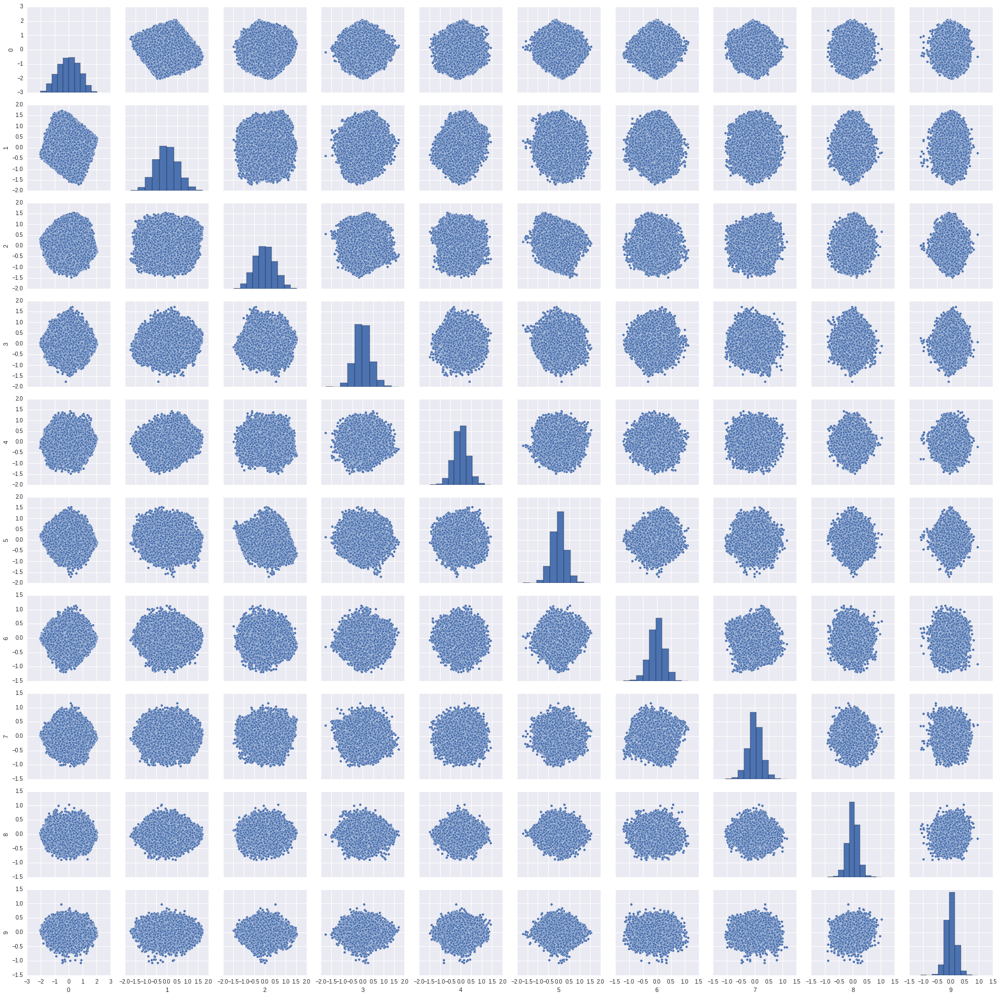

In [13]:
seaborn.pairplot(train_reduced_df)

In [14]:
target_df = train_df.ix[:, [21]]

In [15]:
reduced_train_df_tg = mergeDFByColumn(target_df, train_reduced_df)

In [16]:
raw_test_df = test_df.ix[:, range(1, 22)]
reduced_test_df = computeTopFeaturesPCA(raw_test_df)

## Train model using Logistic Regression Sci-Kit Learn

In [17]:
reduced_train_df_tg.head()

,target,0,1,2,3,4,5,6,7,8,9
0,0,-0.135041,0.336223,-0.120754,0.015917,-0.191340,-0.067127,0.033850,-0.158740,-0.076433,0.079802
1,0,-0.273709,0.211106,0.115552,-0.607145,-0.455373,-0.286743,0.134515,-0.002677,0.051068,-0.013161
2,0,1.144066,0.071588,-0.837514,-0.708459,-0.540568,-0.123382,-0.239667,-0.144035,0.138549,0.164463
3,1,0.564571,0.411345,-0.264677,-0.331694,-0.075474,-0.057602,0.192131,-0.247054,-0.023228,-0.104911
4,0,0.804005,0.467188,0.372105,-0.485091,0.652443,-0.539988,-0.346559,0.404857,0.130938,-0.035898


In [18]:
logit_model = LogisticRegression()

In [19]:
train_features = reduced_train_df_tg.ix[:,range(0, 10)]

In [20]:
logit_model.fit(train_features, reduced_train_df_tg.ix[:,["target"]])

/usr/local/lib/python2.7/dist-packages/sklearn/utils/validation.py:515: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


LogisticRegression(C=1.0, class_weight=None, dual=False, fit_intercept=True,
          intercept_scaling=1, max_iter=100, multi_class='ovr', n_jobs=1,
          penalty='l2', random_state=None, solver='liblinear', tol=0.0001,
          verbose=0, warm_start=False)

## Compute Predictions and Probability on the test data

In [21]:
predictions_and_prob_matrix = logit_model.predict_proba(reduced_test_df)

In [22]:
predictions_and_prob_matrix

array([[ 0.4817798 ,  0.5182202 ],
       [ 0.48919851,  0.51080149],
       [ 0.49838334,  0.50161666],
       ..., 
       [ 0.49092148,  0.50907852],
       [ 0.45013379,  0.54986621],
       [ 0.49226658,  0.50773342]])

In [23]:
class_prob = pd.DataFrame(predictions_and_prob_matrix, columns=["class0", "class1"])

In [24]:
output_df = mergeDFByColumn(test_df.ix[:, ["t_id"]], class_prob.class1)

In [146]:
output_df.to_csv("numerai_data/final_submission.csv", sep=',', encoding='utf-8')

In [25]:
output_df.count()

t_id      36069
class1    36069
dtype: int64